<a href="https://colab.research.google.com/github/bwsi-hadr/04-Intro-to-networks/blob/master/04_Intro_to_networks.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Intro to Networks
The study of networks investigates the relationship between discrete objects using [graphs](https://en.wikipedia.org/wiki/Graph_(discrete_mathematics))

![network_diagram](https://upload.wikimedia.org/wikipedia/commons/2/2f/Small_Network.png)

Graphs are a mathematical structure which represent a set of objects (called nodes or vertices) as well as their symmetric or asymmetric relationships (called links or edges).

They can be used to represent both physical systems (roads, pipelines, electrical grid) and abstract systems (social, collaboration, genetics).

For this course, we'll be using the python `networkx` package, which provides many useful classes and functions for representing and doing computations with networks. 

In addition, we'll be using the `osmnx` package, which will download openstreetmap road networks as `networkx` objects. There are a ton of useful examples in the [examples repo](https://github.com/gboeing/osmnx-examples).

This lecture is based off of the [osmnx-examples](https://github.com/gboeing/osmnx-examples) code and the [Automating GIS Processes](https://automating-gis-processes.github.io/2018/notebooks/L6/retrieve_osm_data.html) course.

In [ ]:
import networkx as nx # need networkx >= 2.5
import osmnx as ox # takes the networks and applies it to the road graph, has geometery and stuff, OX uses networkx
import contextily as ctx 
from matplotlib import pyplot as plt
from shapely.geometry import Polygon
import folium
import numpy as np
import matplotlib.patches as mpatches
import geopandas as gpd
from shapely.ops import nearest_points
import osmnx as ox
import geopandas as gpd
import matplotlib.pyplot as plt

In [39]:
# Specify the name that is used to seach for the data
place_name = "Cambridge, MA, USA"

# Fetch OSM street network from the location
# this will take a while because there's a lot of streets
graph = ox.graph_from_place(place_name)

/opt/conda/lib/python3.11/site-packages/osmnx/graph.py:392: DeprecationWarning: The 'unary_union' attribute is deprecated, use the 'union_all()' method instead.
  polygon = gdf_place["geometry"].unary_union


In [3]:
# metadata about the graph object
graph.graph

{'created_date': '2024-07-19 14:27:42',
 'created_with': 'OSMnx 1.9.3',
 'crs': 'epsg:4326',
 'simplified': True}

In [4]:
# we can save the graph to a file so that we don't have to
# wait for it to download again next time
ox.io.save_graphml(graph, 'cambridge_osmnx.graphml')

In [5]:
# loading graph from a file
graph = ox.io.load_graphml('cambridge_osmnx.graphml')

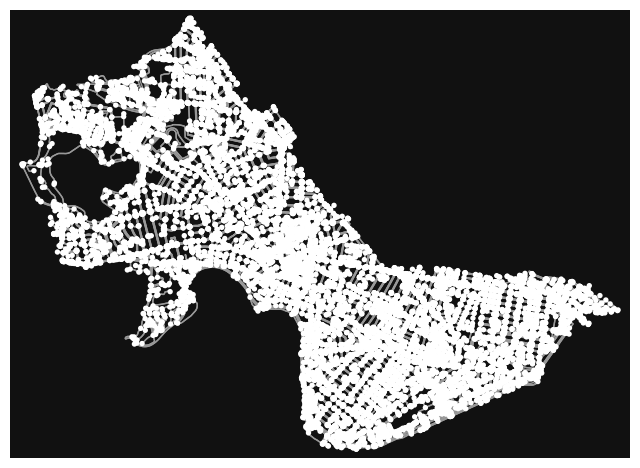

In [7]:
# Let's take a look at the graph
fig, ax = ox.plot_graph(graph)

In [14]:
# we can project the graph into epsg:3857 so that units are in meters
# using the .project_graph() function; 
# by default, osmnx graphs are created in WGS84, (epsg:4326)
graph_proj = ox.project_graph(graph, to_crs='epsg:3857') # meters dataframe 

In [15]:
# we can then convert the projected graph to a geodataframe
graph_nodes_gdf, graph_edges_gdf = ox.graph_to_gdfs(graph_proj) # when you graph you get the nodes and the edges 
graph_nodes_gdf.crs

<Projected CRS: EPSG:3857>
Name: WGS 84 / Pseudo-Mercator
Axis Info [cartesian]:
- X[east]: Easting (metre)
- Y[north]: Northing (metre)
Area of Use:
- name: World between 85.06°S and 85.06°N.
- bounds: (-180.0, -85.06, 180.0, 85.06)
Coordinate Operation:
- name: Popular Visualisation Pseudo-Mercator
- method: Popular Visualisation Pseudo Mercator
Datum: World Geodetic System 1984 ensemble
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

In [16]:
graph_nodes_gdf

,y,x,street_count,lon,lat,highway,ref,geometry
osmid,,,,,,,,
61175693,5.220801e+06,-7.917964e+06,3,-71.128276,42.398103,NaN,NaN,POINT (-7917963.521 5220801.149)
3895955644,5.220746e+06,-7.918006e+06,3,-71.128660,42.397735,NaN,NaN,POINT (-7918006.179 5220745.661)
61182955,5.218854e+06,-7.916612e+06,4,-71.116133,42.385184,traffic_signals,NaN,POINT (-7916611.679 5218853.87)
7893597542,5.218865e+06,-7.916612e+06,4,-71.116138,42.385255,crossing,NaN,POINT (-7916612.247 5218864.676)
7893597530,5.218844e+06,-7.916611e+06,4,-71.116130,42.385119,crossing,NaN,POINT (-7916611.345 5218844.104)
...,...,...,...,...,...,...,...,...
12036296267,5.214481e+06,-7.914626e+06,1,-71.098291,42.356163,NaN,NaN,POINT (-7914625.506 5214481.117)
12036318170,5.214452e+06,-7.914648e+06,1,-71.098489,42.355966,NaN,NaN,POINT (-7914647.547 5214451.531)
12036318175,5.214396e+06,-7.914746e+06,1,-71.099371,42.355596,NaN,NaN,POINT (-7914745.753 5214395.703)


In [17]:
graph_edges_gdf

osmid lanes  \
u           v           key                                               
61175693    3895955644  0                    [8615932, 386272429]     2   
3895955644  8515679674  0                               297244215   NaN   
            1092759643  0                               297244215   NaN   
            61175693    0                    [8615932, 386272429]     2   
61182955    7893597542  0                              1212708764     2   
...                                                           ...   ...   
12036318175 12036318171 0    [1299334778, 1299334779, 1299334780]   NaN   
12036491775 12036491776 0                              1299356038   NaN   
12040230482 12040230483 0                              1299828986   NaN   
            12040230484 0                              1042420666   NaN   
            12040230479 0                              1042420666   NaN   

                                            name              highway width  \
u           v           key                                                   
61175693    3895955644  0         Elmwood Street  [path, residential]  12.2   
3895955644  8515679674  0    Alewife Linear Park             cycleway   NaN   
            1092759643  0    Alewife Linear Park             cycleway   NaN   
            61175693    0         Elmwood Street  [path, residential]  12.2   
61182955    7893597542  0          Oxford Street             tertiary  15.2   
...                                          ...                  ...   ...   
12036318175 12036318171 0                    NaN     [steps, footway]   NaN   
12036491775 12036491776 0                    NaN              service   NaN   
12040230482 12040230483 0                    NaN              footway   NaN   
            12040230484 0                    NaN              footway   NaN   
            12040230479 0                    NaN              footway   NaN   

                             oneway reversed  length  \
u           v           key                            
61175693    3895955644  0     False     True  51.634   
3895955644  8515679674  0     False     True  62.071   
            1092759643  0     False    False  52.446   
            61175693    0     False    False  51.634   
61182955    7893597542  0     False    False   7.984   
...                             ...      ...     ...   
12036318175 12036318171 0     False     True  48.050   
12036491775 12036491776 0     False     True  53.915   
12040230482 12040230483 0     False     True   2.248   
            12040230484 0     False    False  31.113   
            12040230479 0     False     True  18.005   

                                                                      geometry  \
u           v           key                                                      
61175693    3895955644  0    LINESTRING (-7917963.521 5220801.149, -7917972...   
3895955644  8515679674  0    LINESTRING (-7918006.179 5220745.661, -7917922...   
            1092759643  0    LINESTRING (-7918006.179 5220745.661, -7918045...   
            61175693    0    LINESTRING (-7918006.179 5220745.661, -7918002...   
61182955    7893597542  0    LINESTRING (-7916611.679 5218853.87, -7916612....   
...                                                                        ...   
12036318175 12036318171 0    LINESTRING (-7914745.753 5214395.703, -7914776...   
12036491775 12036491776 0    LINESTRING (-7918566.583 5216693.767, -7918586...   
12040230482 12040230483 0    LINESTRING (-7912179.817 5216837.122, -7912177...   
            12040230484 0    LINESTRING (-7912179.817 5216837.122, -7912179...   
            12040230479 0    LINESTRING (-7912179.817 5216837.122, -7912181...   

                            maxspeed service  ref access bridge junction  \
u           v           key                                                
61175693    3895955644  0        NaN     NaN  NaN    NaN    NaN      NaN   
3895955644  8515679674  0       

In [18]:
# we can also get a gdf for the footprint of the place
place_footprint = ox.geocode_to_gdf(place_name)
graph_area = place_footprint.to_crs('epsg:3857')
graph_area

,geometry,bbox_north,bbox_south,bbox_east,bbox_west,place_id,osm_type,osm_id,lat,lon,class,type,place_rank,importance,addresstype,name,display_name
0,"POLYGON ((-7921539.37 5219058.583, -7921287.91...",42.404259,42.352402,-71.063984,-71.160399,17925017,relation,1933745,42.365635,-71.104002,boundary,administrative,16,0.614277,city,Cambridge,"Cambridge, Middlesex County, Massachusetts, Un..."


<Axes: >

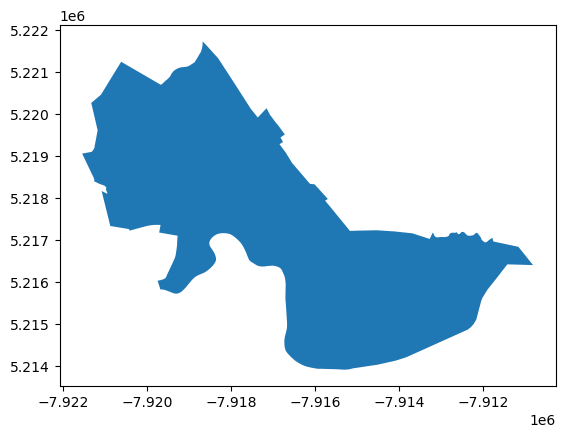

In [19]:
graph_area.plot()

## Exercises
What is the total area of cambridge in sq meters?

How many street segments in Cambridge are longer than 100 meters?

NameError: name 'walkable_roads_near_mit' is not defined

## Road network statistics

In [20]:
# we can get basic stats about the network:
ox.stats.basic_stats(graph_proj)

{'n': 16937,
 'm': 50148,
 'k_avg': 5.921709865973903,
 'edge_length_total': 1644783.0119999878,
 'edge_length_avg': 32.79857645369681,
 'streets_per_node_avg': 3.2491586467497195,
 'streets_per_node_counts': {0: 0,
  1: 1230,
  2: 41,
  3: 9079,
  4: 6476,
  5: 93,
  6: 15,
  7: 1,
  8: 2},
 'streets_per_node_proportions': {0: 0.0,
  1: 0.07262207002420736,
  2: 0.0024207356674735784,
  3: 0.5360453445120151,
  4: 0.3823581507941194,
  5: 0.005490937001830312,
  6: 0.0008856350002952116,
  7: 5.904233335301411e-05,
  8: 0.00011808466670602822},
 'intersection_count': 15707,
 'street_length_total': 903816.8579999988,
 'street_segment_count': 27360,
 'street_length_avg': 33.03424188596487,
 'circuity_avg': 0.7711381724878306,
 'self_loop_proportion': 0.001644736842105263}

Circuity is the ratio of network distance (distance traveled along roads) to euclidean distance (straight line). Higher circuity means greater inefficiency in traveling along the roads.

Check the [documentation](https://osmnx.readthedocs.io/en/stable/osmnx.html#module-osmnx.stats) for more info about each statistic

In [21]:
# if you pass in the area, you can get density info
area_cambridge_sqm = graph_area['geometry'].area
ox.basic_stats(graph_proj, area=area_cambridge_sqm)

{'n': 16937,
 'm': 50148,
 'k_avg': 5.921709865973903,
 'edge_length_total': 1644783.0119999878,
 'edge_length_avg': 32.79857645369681,
 'streets_per_node_avg': 3.2491586467497195,
 'streets_per_node_counts': {0: 0,
  1: 1230,
  2: 41,
  3: 9079,
  4: 6476,
  5: 93,
  6: 15,
  7: 1,
  8: 2},
 'streets_per_node_proportions': {0: 0.0,
  1: 0.07262207002420736,
  2: 0.0024207356674735784,
  3: 0.5360453445120151,
  4: 0.3823581507941194,
  5: 0.005490937001830312,
  6: 0.0008856350002952116,
  7: 5.904233335301411e-05,
  8: 0.00011808466670602822},
 'intersection_count': 15707,
 'street_length_total': 903816.8579999988,
 'street_segment_count': 27360,
 'street_length_avg': 33.03424188596487,
 'circuity_avg': 0.7711381724878306,
 'self_loop_proportion': 0.001644736842105263,
 'node_density_km': 0    502.092163
 dtype: float64,
 'intersection_density_km': 0    465.629191
 dtype: float64,
 'edge_density_km': 0    48759.08725
 dtype: float64,
 'street_density_km': 0    26793.373178
 dtype: fl

## Getting data other ways
In the above example, we used the name of a place to get the data that we wanted.

However, there are other ways to specify locations which may be more convenient.

For example, you can get [graphs from address](https://osmnx.readthedocs.io/en/stable/osmnx.html?highlight=poly#osmnx.core.graph_from_address), [bounding box](https://osmnx.readthedocs.io/en/stable/osmnx.html?highlight=poly#osmnx.core.graph_from_bbox), [points](https://osmnx.readthedocs.io/en/stable/osmnx.html?highlight=poly#osmnx.core.graph_from_bbox), or [shapely polygon object](https://osmnx.readthedocs.io/en/stable/osmnx.html?highlight=poly#osmnx.core.graph_from_polygon)

The types of networks you can get are:

-    `drive` - get drivable public streets (but not service roads)
-    `drive_service` - get drivable streets, including service roads
-    `walk` - get all streets and paths that pedestrians can use (this network type ignores one-way directionality)
-    `bike` - get all streets and paths that cyclists can use
-    `all` - download all non-private OSM streets and paths
-    `all_private` - download all OSM streets and paths, including private-access ones



In [22]:
# Coordinates of the MIT main campus in Decimal Degrees
coordinates = [(-71.092562, 42.357602), (-71.080155, 42.361553),
               (-71.089817, 42.362584), (-71.094688, 42.360198)]

# Create a Shapely polygon from the coordinate-tuple list
poly = Polygon(coordinates)

# convert to meters from latlong by projecting to epsg:3857
poly_m, poly_crs_m = ox.projection.project_geometry(poly, to_crs='epsg:3857')

# put a buffer of 1 mile (1609.34 m) to get everything w/in 1 mile
poly_with_buffer_m = poly_m.buffer(1609.34)

# convert back to lat-long
poly_with_buffer_ll, poly_crs_ll = ox.projection.project_geometry(poly_with_buffer_m, 
                                                        crs=poly_crs_m, 
                                                        to_crs='epsg:4326', 
                                                        to_latlong=True)

'''
# get all walkable roads within poly
walkable_roads_near_mit = ox.graph_from_polygon(poly_with_buffer_ll, 
                                       network_type='walk',
                                       clean_periphery=True)
'''
# Get all walkable roads within poly
walkable_roads_near_mit = ox.graph_from_polygon(
    poly_with_buffer_ll, 
    network_type='walk'
)


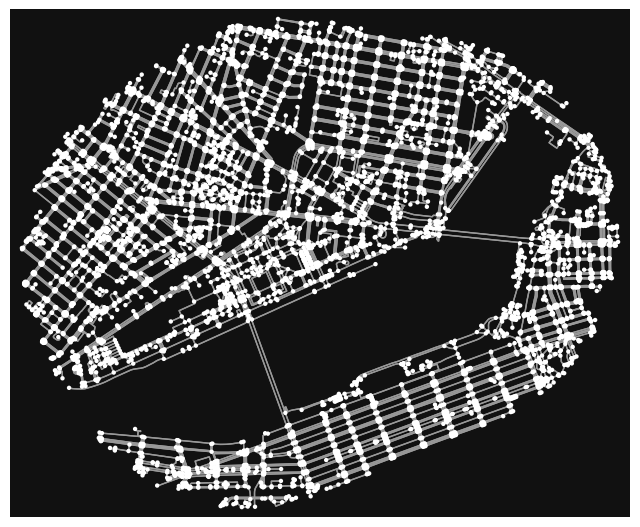

In [23]:
# let's plot it
fig, ax = ox.plot_graph(walkable_roads_near_mit, figsize=(8,10), node_size=10)

In [24]:
# example of a road
all_edges_list = list(walkable_roads_near_mit.edges) # put the id for each edge in a list
print(all_edges_list[0]) # id of first edge
print(walkable_roads_near_mit.edges[all_edges_list[0]]) # get details for first edge

(61283218, 7890342967, 0)
{'osmid': 1288824558, 'oneway': False, 'lanes': '2', 'name': 'Vassar Street', 'highway': 'tertiary', 'width': '17.1', 'reversed': True, 'length': 13.002}


In [25]:
# get attribute for all edges
walkable_roads_near_mit.edges(data='name')

OutMultiEdgeDataView([(61283218, 7890342967, 'Vassar Street'), (61283218, 7890342979, 'Amherst Alley'), (61283218, 5492841607, 'Vassar Street'), (61283269, 7866981406, 'Massachusetts Avenue'), (61283269, 7866981409, 'Massachusetts Avenue'), (61283269, 5737576890, 'Vassar Street'), (61283269, 7866981408, 'Vassar Street'), (61283293, 2694721017, 'Endicott Street'), (61283311, 7579360337, 'Endicott Street'), (61283311, 7071581206, 'Amherst Alley'), (61283311, 9692752987, 'Amherst Alley'), (61283350, 5872296719, 'Main Street'), (61283350, 5872296715, 'Main Street'), (61283350, 7866981387, 'Albany Street'), (61283361, 1053425134, 'Ames Street'), (61283361, 436587028, 'Ames Street'), (61283361, 7899628462, None), (61283361, 1753191577, None), (61283366, 7896253549, 'Technology Square'), (61283366, 5872296719, 'Main Street'), (61283366, 8519179718, 'Main Street'), (61283373, 8602936356, 'Hayward Street'), (61283373, 8646774735, 'Hayward Street'), (61283373, 9272850530, 'Main Street'), (612833

In [26]:
# example of a node (intersection)
all_nodes_list = list(walkable_roads_near_mit.nodes)
print(all_nodes_list[0]) # id of first node
print(walkable_roads_near_mit.nodes[all_nodes_list[0]]) # details for first node

61283218
{'y': 42.3559928, 'x': -71.1033176, 'street_count': 3}


In [27]:
# get attribute for all nodes
walkable_roads_near_mit.nodes(data='street_count')

NodeDataView({61283218: 3, 61283269: 4, 61283293: 1, 61283311: 3, 61283350: 3, 61283361: 4, 61283366: 3, 61283373: 4, 61283385: 3, 61317281: 1, 61317284: 1, 61317286: 3, 61317287: 3, 61317292: 3, 61317293: 3, 61317302: 3, 61317337: 3, 61317338: 3, 61317355: 3, 61317360: 3, 61317365: 3, 61317367: 4, 61317381: 3, 61317382: 3, 61317383: 3, 61317386: 3, 61317414: 1, 61317415: 1, 61317416: 3, 61317420: 5, 61317423: 5, 61317425: 3, 61317454: 3, 61317471: 1, 61317476: 3, 61317478: 3, 61317499: 3, 61317501: 3, 61317503: 3, 61317513: 1, 61317523: 3, 61317588: 4, 61317593: 1, 61317596: 3, 61317645: 1, 61317661: 3, 61317663: 3, 61317667: 4, 61317741: 3, 61317743: 3, 61318059: 4, 61318060: 4, 61318066: 1, 61318074: 1, 61318140: 3, 61318175: 3, 61318434: 4, 61318436: 4, 61318438: 3, 61318454: 3, 61318520: 4, 61318521: 3, 61318534: 4, 61318572: 4, 61318574: 3, 61318575: 3, 61318581: 3, 61318582: 4, 61318586: 3, 61318588: 3, 61318589: 4, 61318592: 3, 61318595: 3, 61318626: 3, 61318627: 3, 61320984: 4

## Exercise

How many walkable roads near MIT are longer than 100 meters?

In [28]:

'''
# walkable_roads_near_mit_m = ox.project_graph(walkable_roads_near_mit, to_crs='epsg:3857']
_, mit_edges_m = ox.graph_to_gdfs(walkable_roads_near_mit)
mit_edges_m[mit_edges_m[ 'length' ] > 100]
'''
# OR
# sum(map(lambda x: 1 if x[-1] > 100 else 0, walkable_roads_near_mit.edges(data='length')))

# breaking this down
total = 0
for x in walkable_roads_near_mit.edges(data='length'):

    if x[-1] > 100:
        total += 1

print(f'The number of walkable roads near MIT that are longer than 100 meters is {total}')


The number of walkable roads near MIT that are longer than 100 meters is 1348


## Routing
We can get the node closest to a point using the `ox.distance.nearest_node` function.

{321504781: {0: {'osmid': 29328109, 'oneway': False, 'highway': 'footway', 'width': '4', 'reversed': True, 'length': 14.434}}}


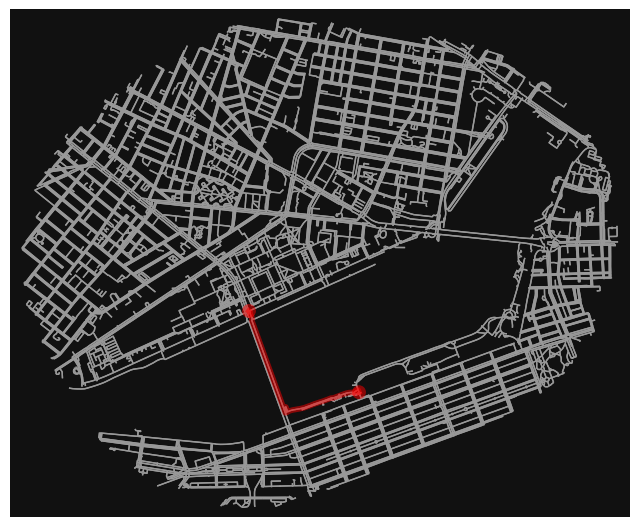

length of shortest walkable path from node 5737576908 to 369608879 is 1188.55m


In [39]:
orig_node = ox.distance.nearest_nodes(walkable_roads_near_mit, -71.092562, 42.357602)

# let's calculate the route to a random destination node
rand_node = np.random.choice(walkable_roads_near_mit.nodes)
print(walkable_roads_near_mit[rand_node])

'''
route = ox.distance.shortest_path(walkable_roads_near_mit, 
                         orig_node, rand_node, 
                         weight='length')
'''
route = ox.routing.shortest_path(walkable_roads_near_mit, 
                         orig_node, rand_node, 
                         weight='length')

fig, ax = ox.plot_graph_route(walkable_roads_near_mit, route, node_size=0)
shortest_path_length = nx.shortest_path_length(walkable_roads_near_mit, orig_node, 
                              rand_node, weight='length')
print(f'length of shortest walkable path from node {orig_node} to {rand_node} is {shortest_path_length:.2f}m') # the {:.2f} syntax means round off to 2 digits after decimal pt

The `shortest_path` function in networkx uses [Dijkstra's algorithm](https://en.wikipedia.org/wiki/Dijkstra%27s_algorithm) to efficiently calculate the shortest path between two nodes. The networkx library also provides many other useful functions on graphs; for instance, the [Floyd-Warshall algorithm](https://en.wikipedia.org/wiki/Floyd%E2%80%93Warshall_algorithm), which efficiently computes the shortest paths between all pairs of nodes, and the [A* (A-star) algorithm](https://en.wikipedia.org/wiki/A*_search_algorithm), which is similar to Dijkstra's algorithm, except it runs faster by taking advantage of a distance "approximation" that can be calculated between two nodes without knowing the shortest path outright. Check out these links if you want to learn more about these algorithms, and check out the [networkx documentation](https://networkx.github.io/documentation/networkx-2.4/index.html) if you want to learn more about all the methods networkx provides.

## Building outlines
We can get the footprint of objects such as buildings as geodataframes with `osmnx`. Here we'll get the building footprints near MIT.

In [29]:
'''
# we can get the footprints of objects within this poly
building_footprints = ox.geometries.geometries_from_polygon(poly_with_buffer_ll, tags={'building':True})
'''
# we can get the footprints of objects within this poly
building_footprints = ox.features.features_from_polygon(poly_with_buffer_ll, tags={'building':True})


You can perform any query using OSM tags: https://wiki.openstreetmap.org/wiki/Map_features

Note that if you include multiple tags, it gets the **union** of the results, not the intersection

In [30]:
'''
road_footprints = ox.geometries.geometries_from_polygon(poly_with_buffer_ll, tags={'highway':True}) # get roads with geometry
# note that most roads do not have footprint information
'''
road_footprints = ox.features.features_from_polygon(poly_with_buffer_ll, tags={'highway':True}) # get roads with geometry
# note that most roads do not have footprint information

In [31]:
# project into UTM for info in meters
building_footprints_proj = ox.projection.project_gdf(building_footprints)
road_footprints_proj = ox.projection.project_gdf(road_footprints)
building_footprints_proj

description level operator railway wheelchair  \
element_type osmid                                                     
node         367777182         NaN   NaN      NaN     NaN        NaN   
             367777193         NaN   NaN      NaN     NaN        NaN   
             367777196         NaN   NaN      NaN     NaN        NaN   
             367777226         NaN   NaN      NaN     NaN        NaN   
             367777292         NaN   NaN      NaN     NaN        NaN   
...                            ...   ...      ...     ...        ...   
relation     16848651          NaN   NaN      NaN     NaN        NaN   
             17409127          NaN   NaN      NaN     NaN        NaN   
             17575546          NaN   NaN      NaN     NaN        NaN   
             17705207          NaN   NaN      NaN     NaN        NaN   
             17804937          NaN   NaN      NaN     NaN        NaN   

                                                                 geometry  \
element_type osmid                                                          
node         367777182                     POINT (327563.105 4691913.104)   
             367777193                     POINT (326878.992 4690851.306)   
             367777196                     POINT (327725.747 4692003.931)   
             367777226                     POINT (329688.089 4691892.609)   
             367777292                     POINT (327397.718 4690775.222)   
...                                                                   ...   
relation     16848651   POLYGON ((327283.553 4692160.017, 327326.644 4...   
             17409127   POLYGON ((327180.012 4691927.952, 327183.457 4...   
             17575546   POLYGON ((327987.438 4690513.203, 327983.717 4...   
             17705207   POLYGON ((329130.431 4692748.495, 329167.555 4...   
             17804937   POLYGON ((327777.158 4692106.398, 327778.165 4...   

                       height access door lockable  ... bicycle_parking area  \
element_type osmid                                  ...                        
node         367777182    NaN    NaN  NaN      NaN  ...             NaN  NaN   
             367777193    NaN    NaN  NaN      NaN  ...             NaN  NaN   
             367777196    NaN    NaN  NaN      NaN  ...             NaN  NaN   
             367777226    NaN    NaN  NaN      NaN  ...             NaN  NaN   
             367777292    NaN    NaN  NaN      NaN  ...             NaN  NaN   
...                       ...    ...  ...      ...  ...             ...  ...   
relation     16848651     NaN    NaN  NaN      NaN  ...             NaN  NaN   
             17409127    20.3    NaN  NaN      NaN  ...             NaN  NaN   
             17575546     NaN    NaN  NaN      NaN  ...             NaN  NaN   
             17705207     NaN    NaN  NaN      NaN  ...             NaN  NaN   
             17804937    48.4    NaN  NaN      NaN  ...             NaN  NaN   

                       abbr_name content opening_date name:signed reservation  \
element_type osmid                                                              
node         367777182       NaN     NaN          NaN         NaN         NaN   
             367777193       NaN     NaN          NaN         NaN         NaN   
             367777196       NaN     NaN          NaN         NaN         NaN   
             367777226       NaN     NaN          NaN         NaN         NaN   
             367777292       NaN     NaN          NaN         NaN         NaN   
...                          ...     ...          ...         ...         ...   
relation     16848651        NaN     NaN          NaN         NaN         NaN   
             17409127        NaN     NaN          NaN         NaN         NaN   
             17575546        NaN     NaN          NaN         NaN         NaN   
             17705207        NaN     NaN          NaN         NaN         NaN   
             17804937        NaN     NaN          NaN         NaN      

In [32]:
# column names
building_footprints_proj.columns.values

array(['description', 'level', 'operator', 'railway', 'wheelchair',
       'geometry', 'height', 'access', 'door', 'lockable', 'man_made',
       'addr:city', 'addr:state', 'building', 'ele', 'gnis:feature_id',
       'name', 'source', 'addr:housenumber', 'addr:postcode',
       'addr:street', 'tourism', 'bicycle', 'amenity', 'maxheight',
       'parking', 'colour', 'toilets', 'toilets:air_conditioning',
       'toilets:disposal', 'toilets:fee', 'toilets:female',
       'toilets:handwashing:soap', 'toilets:hot_water', 'toilets:male',
       'toilets:menstrual_products', 'toilets:paper_supplied',
       'toilets:position', 'toilets:unisex', 'toilets:wheelchair',
       'image', 'covered', 'surface', 'indoor', 'seasonal', 'material',
       'motor_vehicle', 'generator:output:electricity',
       'generator:source', 'location', 'operator:wikidata',
       'operator:wikipedia', 'power', 'ref', 'substation', 'transformer',
       'voltage', 'country', 'lit', 'supervised', 'emergency', 'capa

In [33]:
# drop rows where there's no shape info
building_footprints_proj = building_footprints_proj.dropna(subset=['geometry'])
road_footprints = road_footprints.dropna(subset=['geometry'])

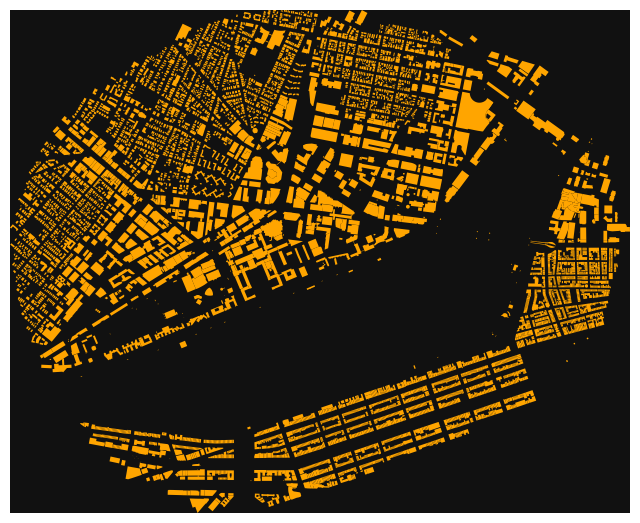

In [34]:
fig, ax = ox.plot_footprints(building_footprints_proj)

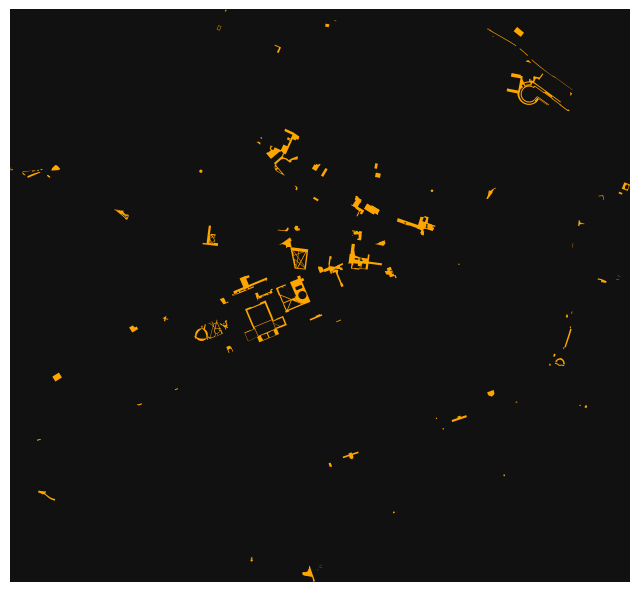

In [35]:
# plot roads with footprints
fig, ax = ox.plot_footprints(road_footprints_proj) # note that this is only a small subset of all roads

In [36]:
# save the geodataframe to a file to persist
# can choose to write only a subset of columns if you want
building_footprints_proj[['description', 'operator', 'railway', 'geometry', 'attribution',
       'source', 'addr:city', 'addr:housenumber', 'addr:postcode',
       'addr:state', 'addr:street', 'amenity']].to_file('buildings_around_mit.geojson', driver='GeoJSON')


# Exercises
Plot the walkable roads and buildings in the area near MIT in the same figure. The `osmnx` plotting features use matplotlib on the backend. Check [the documentation](https://osmnx.readthedocs.io/en/stable/osmnx.html#osmnx.plot.plot_graph) for more formatting options for plotting

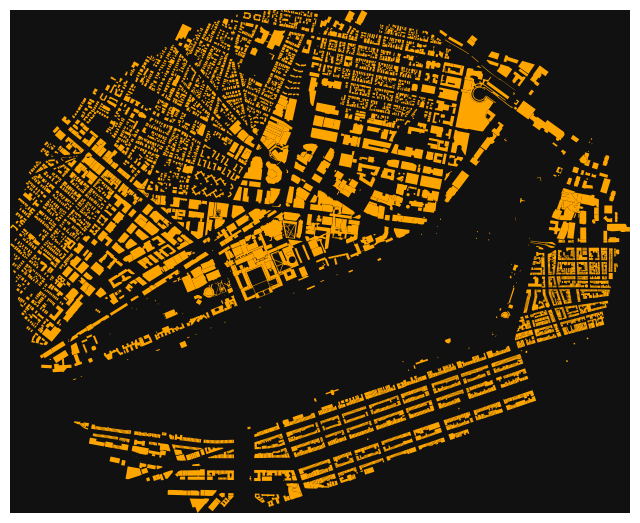

(<Figure size 800x800 with 1 Axes>, <Axes: >)

In [37]:
import pandas as pd
# fig = plt.figure()
# ax = fig.subplots(1,1)

my_gdf = pd.concat((building_footprints_proj, road_footprints_proj), join='inner')
ox.plot_footprints(my_gdf)


In [38]:
# geometries.geometries_from_place is a function that finds the geometeries of points, lines or polygons based on the name of the places

icecream = ox.features.features_from_polygon(first_row_geometry, tags={'amenity': 'ice_cream'})

fig, ax = plt.subplots(figsize=(10, 10))

# Plotting the ice cream locations 
icecream.plot(ax=ax, markersize=80, color='blue', alpha=0.9, marker='o')

ax.set_xlim(-71.16, -71.06) 
ax.set_ylim(42.343, 42.41)  

# basemap using contextily 
ctx.add_basemap(ax, crs=icecream.crs, source=ctx.providers.OpenStreetMap.Mapnik)

# plotting cambridge polygon
graph_area.plot(ax=ax, alpha=0.4)

plt.show()

NameError: name 'first_row_geometry' is not defined

Now, go back to one of the previous exercises and plot all the nodes on the periphery of Cambridge and the roads in Cambridge in the same figure.

## Interactive graph with folium
Folium is a library which creates interactive web maps. This can be used to visualize and explore the data. However, it is slower to load and cannot scale to as large networks as the standard matplotlib plotting

In [147]:
pip install folium matplotlib mapclassify


  Using cached mapclassify-2.7.0-py3-none-any.whl.metadata (2.8 kB)
Using cached mapclassify-2.7.0-py3-none-any.whl (58 kB)
Note: you may need to restart the kernel to use updated packages.


In [148]:
'''
folium_graph = ox.plot_graph_folium(walkable_roads_near_mit)
folium_graph
'''
import osmnx as ox
# pip install folium matplotlib mapclassify
# Convert the walkable roads graph to GeoDataFrames
graph_nodes_gdf, graph_edges_gdf = ox.graph_to_gdfs(walkable_roads_near_mit)

# Use the explore method to create an interactive web map
map_edges = graph_edges_gdf.explore()

# Optionally, you can save the map to an HTML file to view it in a browser
map_edges.save('walkable_roads_near_mit.html')

# To display the map in a Jupyter notebook
map_edges


In [149]:
'''
ox.plot_route_folium(walkable_roads_near_mit, route, route_map = folium_graph, color='#ff0000')
'''
import geopandas as gpd
from shapely.geometry import LineString


# Extract the route geometry
route_nodes_gdf = graph_nodes_gdf.loc[route]
route_line = LineString(route_nodes_gdf.geometry.tolist())

# Create a GeoDataFrame for the route
route_gdf = gpd.GeoDataFrame(geometry=[route_line], crs=graph_edges_gdf.crs)

# Add the route to the map
map_edges = route_gdf.explore(m=map_edges, color='#ff0000', tooltip=False)

# To display the map in a Jupyter notebook
map_edges


## Get places of interest
OSM can also give places of interest, like restaurants, pharmacies, hospitals, and toilets. The full list is available [here](https://wiki.openstreetmap.org/wiki/Key:amenity).

Let's look at the POIs near MIT.

In [150]:
'''
fast_food = ox.geometries.geometries_from_polygon(poly_with_buffer_ll, tags={'amenity': 'fast_food'})
'''
fast_food = ox.features.features_from_polygon(poly_with_buffer_ll, tags={'amenity': 'fast_food'})
fast_food

addr:housenumber addr:postcode           addr:street  \
element_type osmid                                                              
node         566889950                263         02139      Brookline Street   
             566890089                272         02139      Brookline Street   
             1735987384               280           NaN      Cambridge Street   
             2134089521               598         02139  Massachusetts Avenue   
             2350393263               530         02215   Commonwealth Avenue   
             2367929358               540         02215   Commonwealth Avenue   
             2428711851               NaN           NaN                   NaN   
             2428711853               NaN           NaN                   NaN   
             2430573649               NaN           NaN                   NaN   
             2446018087               NaN           NaN                   NaN   
             2501165514               NaN           NaN                   NaN   
             2560514681               245           NaN  Massachusetts Avenue   
             2686928559               255         02142           Main Street   
             2700809502               242         02114      Cambridge Street   
             2707976346               736         02139  Massachusetts Avenue   
             2707976349               744         02139  Massachusetts Avenue   
             2708166079               277         02114      Cambridge Street   
             3773606173                26         02139                   NaN   
             4354050789                42           NaN        Charles Street   
             4360543289                 4         02139                   NaN   
             4406184596               300         02114      Cambridge Street   
             4406184597               296         02114      Cambridge Street   
             4406195907               161         02114        Charles Street   
             4722509102               181         02139  Massachusetts Avenue   
             5019071925               NaN           NaN                   NaN   
             5122876709               181         02139  Massachusetts Avenue   
             5627766951               292           NaN  Massachusetts Avenue   
             5633740689               NaN           NaN                   NaN   
             5633753513               NaN           NaN                   NaN   
             5811134127               225         02116        Newbury Street   
             6117409528               301           NaN          Third Street   
             7501883775               234         02116        Newbury Street   
             7625672550              324a         02115        Newbury Street   
             7735023387               255         02116        Newbury Street   
             7785682404               244         02116        Newbury Street   
             7911407804               NaN           NaN                   NaN   
             7924592200                 1         02142              Broadway   
             9701394228               NaN           NaN                   NaN   
             9749969793               625         02142   West Kendall Street   
             9925922688               NaN           NaN                   NaN   
             10760274783               23           NaN       Prospect Street   
             11543746984              201         02142   Galileo Galilei Way   
way          29938285                 463         02139  Massachusetts Avenue   

                            amenity  check_date              cuisine  \
element_type osmid                                                     
node         566889950    fast_food  2023-05-16                pizza   
             566890089    fast_food         NaN                greek   
             1735987384   fast_food         NaN                pizza   
             213408

In [151]:
walkable_nodes, walkable_edges = ox.graph_to_gdfs(walkable_roads_near_mit)

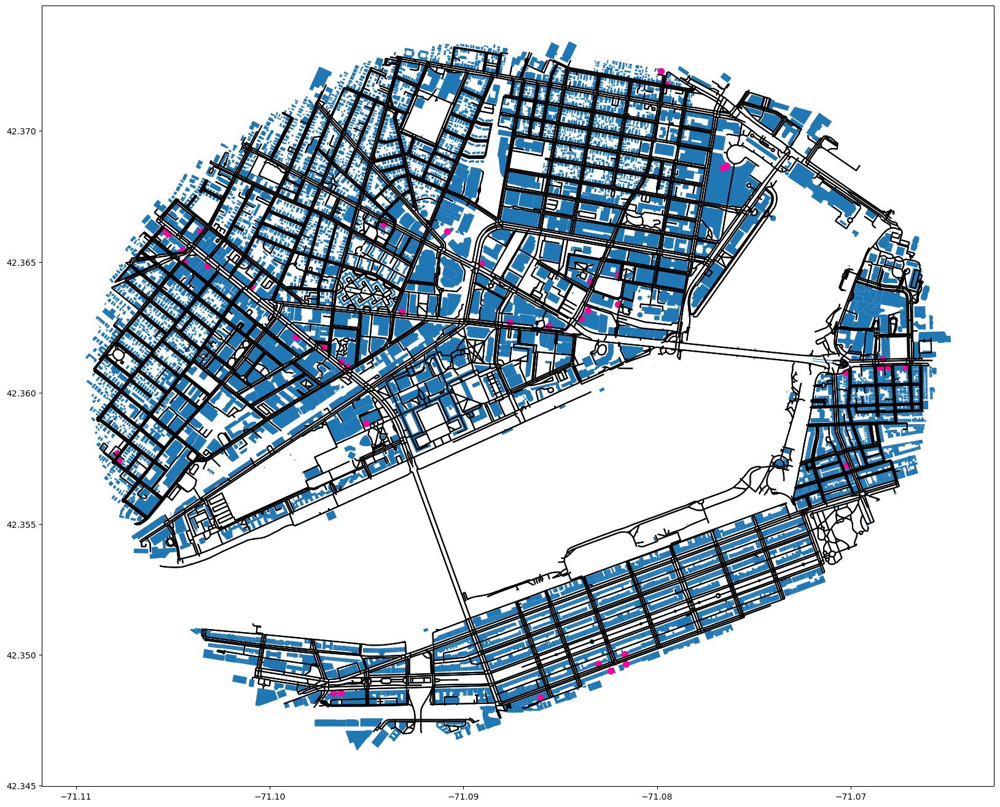

In [152]:
# plot roads, buildings, and fast_food
fig, ax = plt.subplots(1,1, figsize=[20,20])
building_footprints.plot(ax=ax)
walkable_edges.plot(ax=ax, color='black')
fast_food.plot(ax=ax, color='#FF0099', markersize=50)
plt.show()

# Exercise
In groups, pick a location, ask an interesting question, do an analysis to answer that question.


In [40]:
Bronx_name = "Bronx, New York, USA"

In [41]:
graph_Bronx = ox.graph_from_place(Bronx_name)

graph_proj_Bronx = ox.project_graph(graph_Bronx, to_crs='epsg:4326')

graph_nodes_Bronx_gdf, graph_edges_Bronx_gdf = ox.graph_to_gdfs(graph_proj_Bronx)

print(graph_nodes_Bronx_gdf.crs)

place_footprint = ox.geocode_to_gdf(Bronx_name)

graph_area_bronx = place_footprint.to_crs('epsg:4326')

graph_area_bronx

/opt/conda/lib/python3.11/site-packages/osmnx/graph.py:392: DeprecationWarning: The 'unary_union' attribute is deprecated, use the 'union_all()' method instead.
  polygon = gdf_place["geometry"].unary_union


epsg:4326


,geometry,bbox_north,bbox_south,bbox_east,bbox_west,place_id,osm_type,osm_id,lat,lon,class,type,place_rank,importance,addresstype,name,display_name
0,"POLYGON ((-73.93391 40.88201, -73.9253 40.8790...",40.91763,40.785739,-73.748374,-73.933907,15675078,relation,9691916,40.846651,-73.878594,boundary,administrative,14,0.610803,suburb,The Bronx,"The Bronx, New York, United States"


In [ ]:
polygon_bronx = graph_area_bronx.loc[0,'geometry']

/opt/conda/lib/python3.11/site-packages/osmnx/graph.py:392: DeprecationWarning: The 'unary_union' attribute is deprecated, use the 'union_all()' method instead.
  polygon = gdf_place["geometry"].unary_union


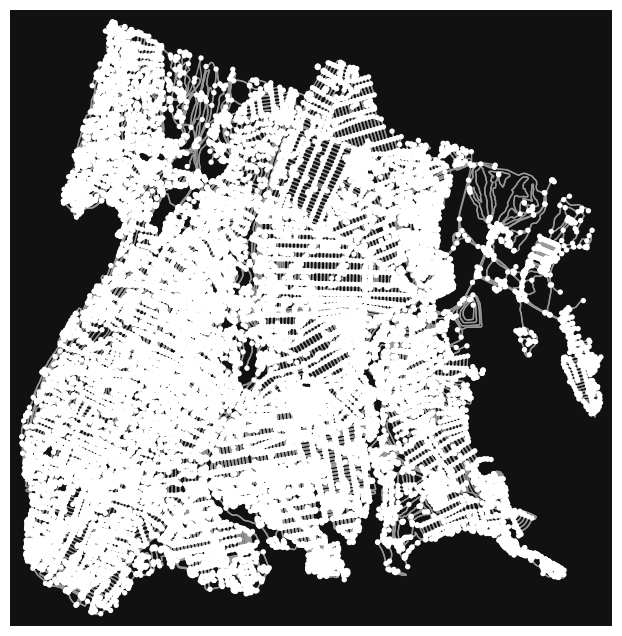

epsg:4326


In [172]:
graph = ox.graph_from_place(Bronx_name)

ox.io.save_graphml(graph, 'bronx_osmnx.graphml')

graph = ox.io.load_graphml('bronx_osmnx.graphml')

fig, ax = ox.plot_graph(graph)

graph_proj = ox.project_graph(graph, to_crs='epsg:4326')

graph_nodes_gdf, graph_edges_gdf = ox.graph_to_gdfs(graph_proj)
print(graph_nodes_gdf.crs)


In [176]:
all_healthcare = ox.features.features_from_polygon(polygon_bronx, tags={'amenity': 'hospital'})
all_healthcare

RuntimeError: Unable to determine UTM CRS

In [42]:
import osmnx as ox
import matplotlib.pyplot as plt
import contextily as ctx


In [43]:
Bronx_name = "Bronx, New York, USA"

graph_Bronx = ox.graph_from_place(Bronx_name)

graph_proj_Bronx = ox.project_graph(graph_Bronx, to_crs='epsg:4326')

graph_nodes_Bronx_gdf, graph_edges_Bronx_gdf = ox.graph_to_gdfs(graph_proj_Bronx)

print("CRS of nodes GeoDataFrame:", graph_nodes_Bronx_gdf.crs)

place_footprint = ox.geocode_to_gdf(Bronx_name)

graph_area_bronx = place_footprint.to_crs('epsg:4326')


/opt/conda/lib/python3.11/site-packages/osmnx/graph.py:392: DeprecationWarning: The 'unary_union' attribute is deprecated, use the 'union_all()' method instead.
  polygon = gdf_place["geometry"].unary_union


CRS of nodes GeoDataFrame: epsg:4326


In [44]:
polygon_bronx = graph_area_bronx.loc[0, 'geometry']

all_healthcare = ox.features.features_from_polygon(polygon_bronx, tags={'amenity': 'hospital'})

all_healthcare = all_healthcare.to_crs('epsg:4326')

/opt/conda/lib/python3.11/site-packages/contextily/tile.py:623: UserWarning: The inferred zoom level of 30 is not valid for the current tile provider (valid zooms: 0 - 19).
  warnings.warn(msg)


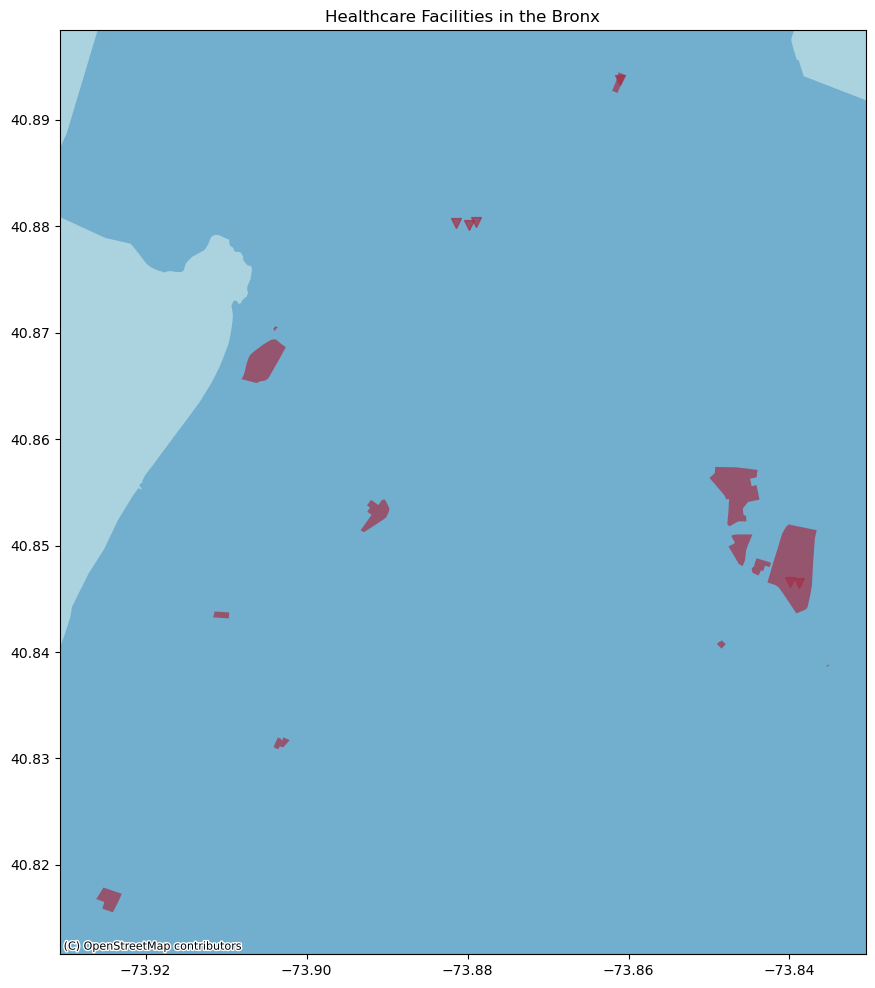

In [45]:
fig, ax = plt.subplots(figsize=(12, 12))

all_healthcare.plot(ax=ax, marker='v', color='red', markersize=50, alpha=0.7)

ctx.add_basemap(ax, crs='epsg:3857', source=ctx.providers.OpenStreetMap.Mapnik)

graph_area_bronx.plot(ax=ax, alpha=0.4)

ax.set_title('Healthcare Facilities in the Bronx')

plt.show()


In [202]:
len(all_healthcare)

19

In [46]:
population = 1472654
population_hospital_ratio = population/19
population_hospital_ratio

77508.1052631579

/opt/conda/lib/python3.11/site-packages/osmnx/graph.py:392: DeprecationWarning: The 'unary_union' attribute is deprecated, use the 'union_all()' method instead.
  polygon = gdf_place["geometry"].unary_union
/tmp/ipykernel_103/3987729136.py:27: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  plt.legend()


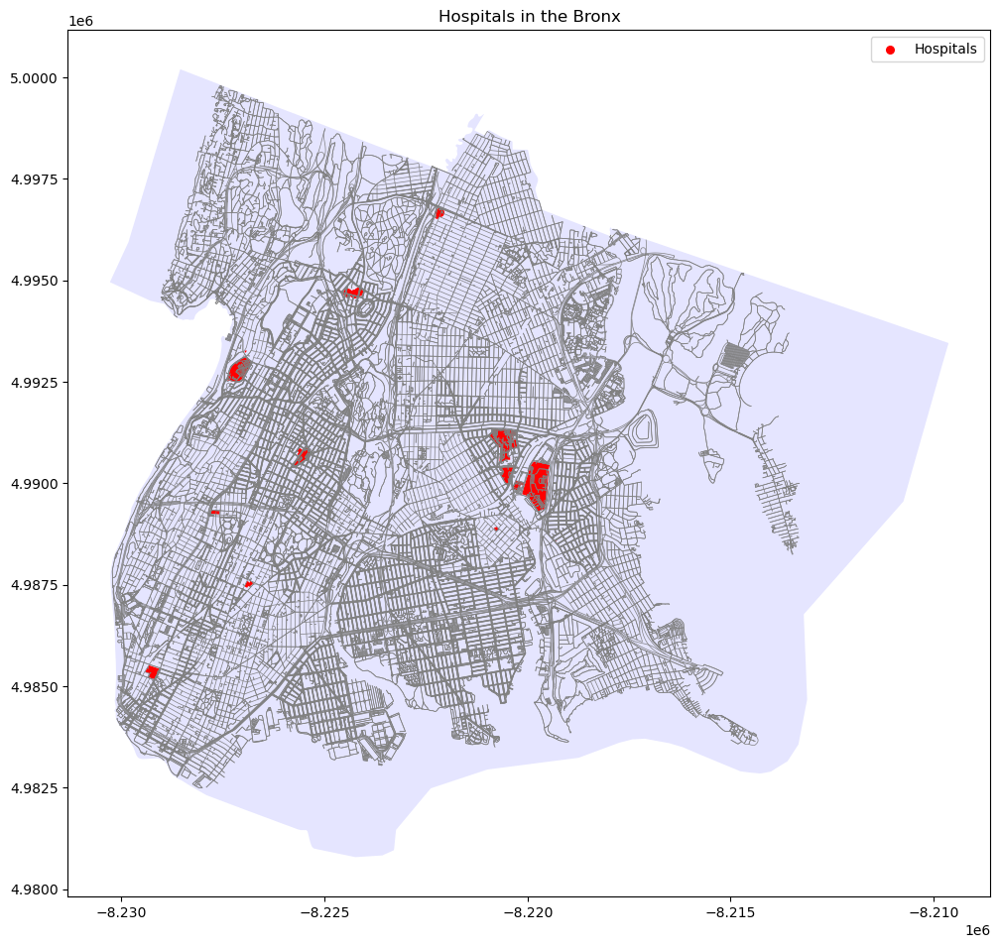

In [56]:
place_name = "Bronx, New York, USA"

graph_Bronx = ox.graph_from_place(place_name, network_type='all')
graph_proj_Bronx = ox.project_graph(graph_Bronx, to_crs='epsg:3857')

graph_nodes_Bronx_gdf, graph_edges_Bronx_gdf = ox.graph_to_gdfs(graph_proj_Bronx)

polygon = ox.geocode_to_gdf(place_name)

hospital = ox.features.features_from_polygon(polygon.geometry.iloc[0], tags={'amenity': 'hospital'})

# polygon and hospital data to EPSG:3857
polygon = polygon.to_crs(epsg=3857)
hospital = hospital.to_crs(epsg=3857)

# plotting
fig, ax = plt.subplots(figsize=(12, 12))

graph_edges_Bronx_gdf.plot(ax=ax, linewidth=0.5, edgecolor='gray')

polygon.plot(ax=ax, alpha=0.1, color='blue')

hospital.plot(ax=ax, marker='o', color='red', markersize=30, label='Hospitals')

ax.set_aspect('equal')
ax.set_title('Hospitals in the Bronx')
plt.legend()

plt.show()

ox.io.save_graphml(graph_Bronx, 'Bronx_hospital_osmnx.graphml')

In [58]:
hospital.to_csv('Bronx_HospitalFootprint.csv', index=False)


In [81]:
hospital.to_file("Bronx_healthcare_footprints.geojson", driver='GeoJSON')


In [84]:
# merging 
# reading each burrow
bronx_hospitals = pd.read_file('Bronx_HospitalFootprint.csv')
brooklyn_hospitals = pd.read_file('Brooklyn_HospitalFootprint.csv')
queens_hospitals = gpd.read_file('queens_hospital.csv')
manhattan_hospitals = gpd.read_file('manhattan_hospitals.csv')
staten_island_hospitals = gpd.read_file('StatenIsland_HospitalFootprint.csv')

AttributeError: module 'pandas' has no attribute 'read_file'

In [71]:
all_hospitals = pd.concat([bronx_hospitals, brooklyn_hospitals, queens_hospitals, manhattan_hospitals, staten_island_hospitals], ignore_index=True)
all_hospitals

,addr:city,addr:housenumber,addr:postcode,addr:street,amenity,beds,emergency,gnis:feature_id,healthcare,name,...,building,check_date,loc_name,ways,building:levels,type,surrounding_pop,tract_pop,tract_area,tract_density
0,Bronx,111,10467,East 210th Street,hospital,726,yes,957548,hospital,Montefiore Medical Center West Campus Moses Di...,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,Bronx,1300,10461,Waters Place,hospital,,no,1993274,hospital,New York City Children's Center Bronx Campus,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,Bronx,3424,10467,Kossuth Avenue,hospital,,yes,2072352,hospital,North Central Bronx Hospital,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,Bronx,3415,10467,Bainbridge Avenue,hospital,,,,hospital,Children's Hospital at Montefiore,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,Bronx,4141,10466,Carpenter Avenue,hospital,,,,hospital,Montefiore Medical Center - Wakefield Campus,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
98,Staten Island,475,10305,Seaview Avenue,hospital,,yes,,hospital,Staten Island University Hospital,...,NaN,NaN,NaN,,NaN,,NaN,NaN,NaN,NaN
99,Staten Island,777,10305,Seaview Avenue,hospital,,no,,hospital,Staten Island Children and Youth Day Treatment...,...,NaN,NaN,NaN,,NaN,,NaN,NaN,NaN,NaN
100,Staten Island,355,10310,Bard Avenue,hospital,300,yes,964267,hospital,Richmond University Medical Center,...,NaN,NaN,NaN,,NaN,,NaN,NaN,NaN,NaN
101,Staten Island,75,10304,Vanderbilt Avenue,hospital,,no,,hospital,Bayley Seton Hospital,...,NaN,NaN,NaN,,NaN,,NaN,NaN,NaN,NaN


In [72]:
all_hospitals['geometry']

0           POINT (-8224266.602834538 4994670.330251723)
1           POINT (-8219700.678072365 4989722.669196329)
2           POINT (-8224439.437475944 4994710.495286703)
3           POINT (-8224161.305728197 4994712.615439776)
4           POINT (-8222178.059944122 4996686.324678281)
                             ...                        
98     POLYGON ((-74.0842748 40.5827709, -74.081624 4...
99     POLYGON ((-74.0816471 40.5814338, -74.0791629 ...
100    POLYGON ((-74.1064204 40.6347812, -74.1040369 ...
101    POLYGON ((-74.0756476 40.6209802, -74.0747568 ...
102    MULTIPOLYGON (((-74.1983605 40.5167879, -74.19...
Name: geometry, Length: 103, dtype: object

In [101]:

manhattan_polygon_gdf = gpd.read_file("manhattan_hospitals.geojson")
brooklyn_polygon_gdf = gpd.read_file("Brooklyn_HospitalFootprint.geojson")
statenisland_polygon_gdf = gpd.read_file("StatenIsland_HospitalFootprint.geojson")
queens_polygon_gdf = gpd.read_file("queens_hospital.geojson")
bronx_polygon_gdf = gpd.read_file("Bronx_healthcare_footprints.geojson")

common_crs = 'epsg:4326'

manhattan_polygon_gdf = manhattan_polygon_gdf.to_crs(common_crs)
brooklyn_polygon_gdf = brooklyn_polygon_gdf.to_crs(common_crs)
statenisland_polygon_gdf = statenisland_polygon_gdf.to_crs(common_crs)
queens_polygon_gdf = queens_polygon_gdf.to_crs(common_crs)
bronx_polygon_gdf = bronx_polygon_gdf.to_crs(common_crs)\

nyc_boroughs_gdf = pd.concat([manhattan_polygon_gdf, brooklyn_polygon_gdf, statenisland_polygon_gdf, queens_polygon_gdf, bronx_polygon_gdf], ignore_index=True)

nyc_boroughs_gdf = gpd.GeoDataFrame(nyc_boroughs_gdf, crs='epsg:4326')

nyc_boroughs_gdf.explore()





Skipping field nodes: unsupported OGR type: 13
Skipping field ways: unsupported OGR type: 1
Skipping field ways: unsupported OGR type: 1
Skipping field ways: unsupported OGR type: 1
Skipping field nodes: unsupported OGR type: 13
